## Librerias a utilizar

In [1]:
import pandas as pd  # importar pandas para poder leer los archivos .csv
import matplotlib.pyplot as plt # crear graficas
import seaborn as sns 
import numpy as np
import folium

from statsmodels.tsa.deterministic import DeterministicProcess, CalendarFourier


from folium.plugins import MarkerCluster
from geopy.geocoders import Nominatim

## Importar Base de datos

In [2]:
#importar los datos de los crimenes de LA.
los_angeles_data = "/Users/oscar_sanchez/Desktop/TFG/LA/src/Crime_Data_from_2010_to_2019.csv"
df_crimes = pd.read_csv(los_angeles_data, encoding='latin1')

In [3]:
df_crimes.head()

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,1307355,02/20/2010 12:00:00 AM,02/20/2010 12:00:00 AM,1350,13,Newton,1385,2,900,VIOLATION OF COURT ORDER,...,AA,Adult Arrest,900.0,NaN,NaN,NaN,300 E GAGE AV,NaN,33.9825,-118.2695
1,11401303,09/13/2010 12:00:00 AM,09/12/2010 12:00:00 AM,45,14,Pacific,1485,2,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",...,IC,Invest Cont,740.0,NaN,NaN,NaN,SEPULVEDA BL,MANCHESTER AV,33.9599,-118.3962
2,70309629,08/09/2010 12:00:00 AM,08/09/2010 12:00:00 AM,1515,13,Newton,1324,2,946,OTHER MISCELLANEOUS CRIME,...,IC,Invest Cont,946.0,NaN,NaN,NaN,1300 E 21ST ST,NaN,34.0224,-118.2524
3,90631215,01/05/2010 12:00:00 AM,01/05/2010 12:00:00 AM,150,6,Hollywood,646,2,900,VIOLATION OF COURT ORDER,...,IC,Invest Cont,900.0,998.0,NaN,NaN,CAHUENGA BL,HOLLYWOOD BL,34.1016,-118.3295
4,100100501,01/03/2010 12:00:00 AM,01/02/2010 12:00:00 AM,2100,1,Central,176,1,122,"RAPE, ATTEMPTED",...,IC,Invest Cont,122.0,NaN,NaN,NaN,8TH ST,SAN PEDRO ST,34.0387,-118.2488


# LIMPIAMOS BASE DE DATOS SI ES NECESARIO

In [4]:
df_crimes = df_crimes[((df_crimes['LON'] > 0.1) | (df_crimes['LON'] < -0.1)) & ((df_crimes['LAT'] < -0.1) | (df_crimes['LAT'] > 0.1))]
df_crimes = df_crimes[((df_crimes["Vict Sex"] == "M") | (df_crimes["Vict Sex"] == "F"))]
display(df_crimes.isna().sum())
df_crimes.reset_index(inplace=True, drop=True)

DR_NO                   0
Date Rptd               0
DATE OCC                0
TIME OCC                0
AREA                    0
AREA NAME               0
Rpt Dist No             0
Part 1-2                0
Crm Cd                  0
Crm Cd Desc             0
Mocodes             30653
Vict Age                0
Vict Sex                0
Vict Descent           47
Premis Cd              27
Premis Desc           119
Weapon Used Cd    1165051
Weapon Desc       1165052
Status                  2
Status Desc             0
Crm Cd 1               10
Crm Cd 2          1733340
Crm Cd 3          1863409
Crm Cd 4          1866776
LOCATION                0
Cross Street      1561407
LAT                     0
LON                     0
dtype: int64

In [5]:
delete_columns = [
    'DR_NO',
    'Rpt Dist No',
    'Date Rptd',
    'Part 1-2',
    'Mocodes',
    'Vict Descent',
    'Premis Cd',
    'Premis Desc',
    'Weapon Used Cd',
    'Weapon Desc',
    'Status',
    'Status Desc',
    'Crm Cd 1',
    'Crm Cd 2',
    'Crm Cd 3',
    'Crm Cd 4',
    'Cross Street',
]
df_crimes.drop(delete_columns, axis=1, inplace=True)

In [6]:
display(df_crimes.isna().sum())

DATE OCC       0
TIME OCC       0
AREA           0
AREA NAME      0
Crm Cd         0
Crm Cd Desc    0
Vict Age       0
Vict Sex       0
LOCATION       0
LAT            0
LON            0
dtype: int64

## FILTRAR DATASET POR AGRESIONES SEXUALES

In [7]:
df_filtered = df_crimes[df_crimes['Crm Cd Desc'].str.contains('sexual', case=False, na=False) | df_crimes['Crm Cd Desc'].str.contains('rape', case=False, na=False)]

In [8]:
df_filtered['Crm Cd Desc'].unique()

array(['RAPE, ATTEMPTED', 'RAPE, FORCIBLE', 'BATTERY WITH SEXUAL CONTACT',
       'SODOMY/SEXUAL CONTACT B/W PENIS OF ONE PERS TO ANUS OTH',
       'SEXUAL PENETRATION W/FOREIGN OBJECT',
       'BEASTIALITY, CRIME AGAINST NATURE SEXUAL ASSLT WITH ANIM',
       'INCEST (SEXUAL ACTS BETWEEN BLOOD RELATIVES)'], dtype=object)

In [9]:
# eliminamos los que no nos interesan, ya que no son datos de violencia de genero. 
valores_a_eliminar = ['BEASTIALITY, CRIME AGAINST NATURE SEXUAL ASSLT WITH ANIM', 'INCEST (SEXUAL ACTS BETWEEN BLOOD RELATIVES)']
df_filtered = df_filtered[~df_filtered['Crm Cd Desc'].isin(valores_a_eliminar)]

#recortar nombre
df_filtered.replace('SODOMY/SEXUAL CONTACT B/W PENIS OF ONE PERS TO ANUS OTH','SODOMY/SEXUAL CONTACT', inplace=True)

In [10]:
df_filtered['Crm Cd Desc'].unique()

array(['RAPE, ATTEMPTED', 'RAPE, FORCIBLE', 'BATTERY WITH SEXUAL CONTACT',
       'SODOMY/SEXUAL CONTACT', 'SEXUAL PENETRATION W/FOREIGN OBJECT'],
      dtype=object)

In [11]:
df_filtered

,DATE OCC,TIME OCC,AREA,AREA NAME,Crm Cd,Crm Cd Desc,Vict Age,Vict Sex,LOCATION,LAT,LON
4,01/02/2010 12:00:00 AM,2100,1,Central,122,"RAPE, ATTEMPTED",47,F,8TH ST,34.0387,-118.2488
59,03/06/2010 12:00:00 AM,420,1,Central,121,"RAPE, FORCIBLE",28,F,400 S FIGUEROA ST,34.0535,-118.2560
171,05/16/2010 12:00:00 AM,300,1,Central,860,BATTERY WITH SEXUAL CONTACT,59,F,600 S SAN PEDRO,34.0423,-118.2452
244,06/25/2010 12:00:00 AM,2345,1,Central,121,"RAPE, FORCIBLE",13,F,500 S SPRING ST,34.0474,-118.2496
299,07/24/2010 12:00:00 AM,100,1,Central,121,"RAPE, FORCIBLE",28,F,500 N HILL ST,34.0589,-118.2412
...,...,...,...,...,...,...,...,...,...,...,...
1866649,06/30/2019 12:00:00 AM,200,6,Hollywood,860,BATTERY WITH SEXUAL CONTACT,25,F,SELMA,34.0997,-118.3361
1866667,06/04/2019 12:00:00 AM,200,8,West LA,860,BATTERY WITH SEXUAL CONTACT,40,M,11700 SAN VICENTE BL,34.0536,-118.4655
1866684,04/14/2019 12:00:00 AM,200,16,Foothill,860,BATTERY WITH SEXUAL CONTACT,17,F,13000 CARL ST,34.2688,-118.4158
1866779,06/30/2019 12:00:00 AM,730,11,Northeast,121,"RAPE, FORCIBLE",23,F,800 N AVENUE 64,34.1208,-118.1778


In [12]:
print('El numero total de crímenes de la base de datos original: ',df_crimes.shape[0])
print('El numero total de crímenes de la base de datos filtrada por agresiones sexuales: ',df_filtered.shape[0])

porcentaje_crim_viol_gen = (df_filtered.shape[0] / df_crimes.shape[0]) * 100

print(f'El porcentaje de crímenes relacionados con violencia de género es de {porcentaje_crim_viol_gen:.2f}%')

El numero total de crímenes de la base de datos original:  1866880
El numero total de crímenes de la base de datos filtrada por agresiones sexuales:  27615
El porcentaje de crímenes relacionados con violencia de género es de 1.48%


## ANÁLISIS

In [13]:
df_filtered.columns

Index(['DATE OCC', 'TIME OCC', 'AREA ', 'AREA NAME', 'Crm Cd', 'Crm Cd Desc',
       'Vict Age', 'Vict Sex', 'LOCATION', 'LAT', 'LON'],
      dtype='object')

### Porcentaje de cada tipo de agresión por año

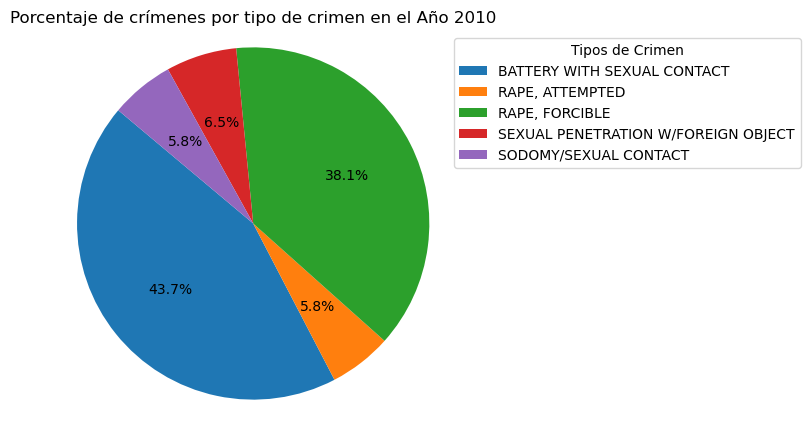

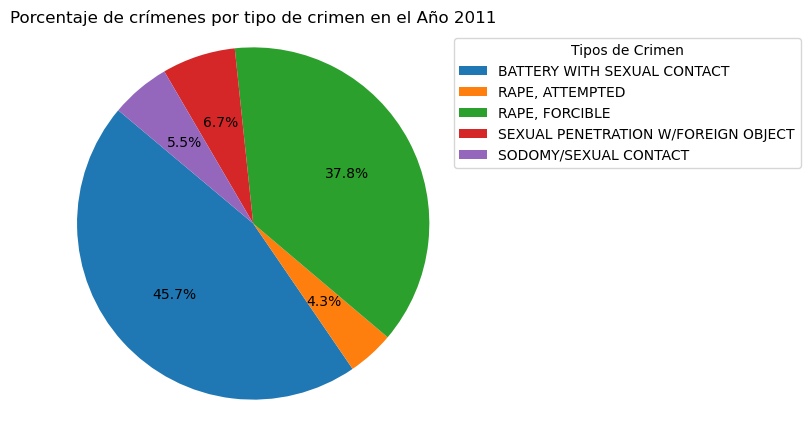

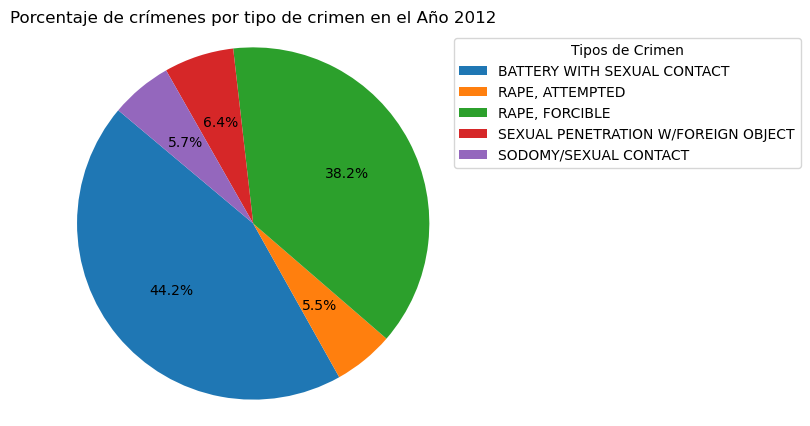

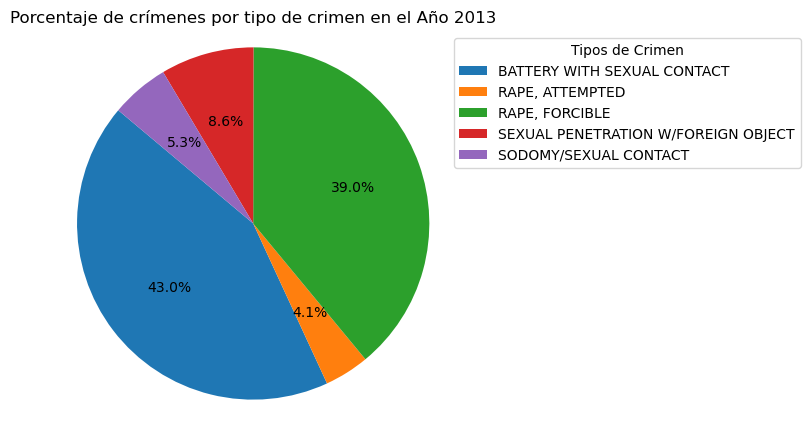

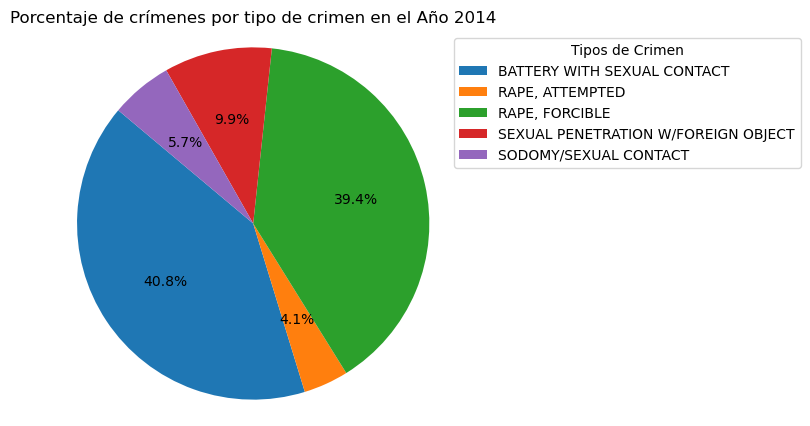

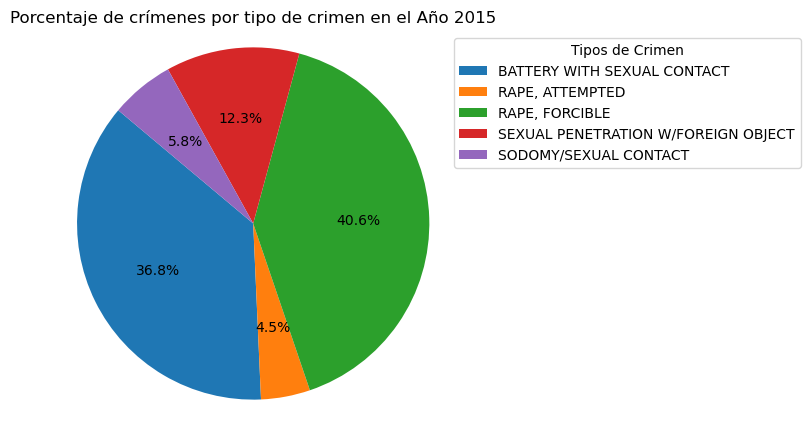

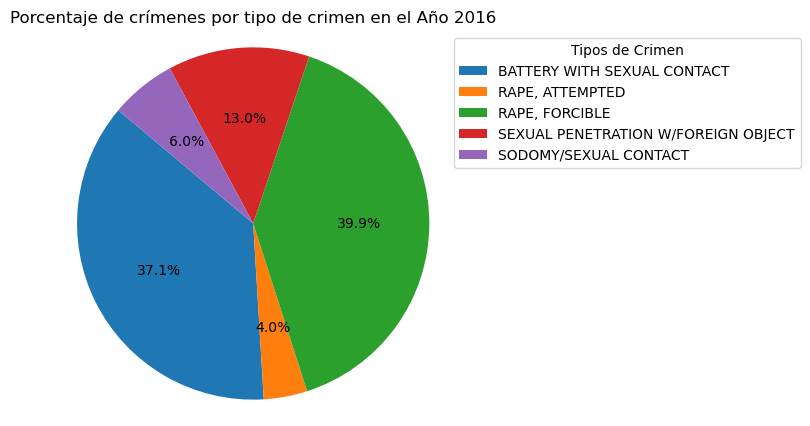

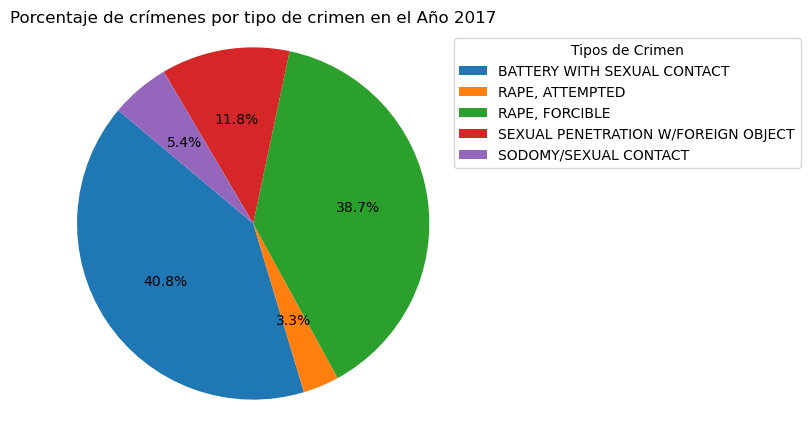

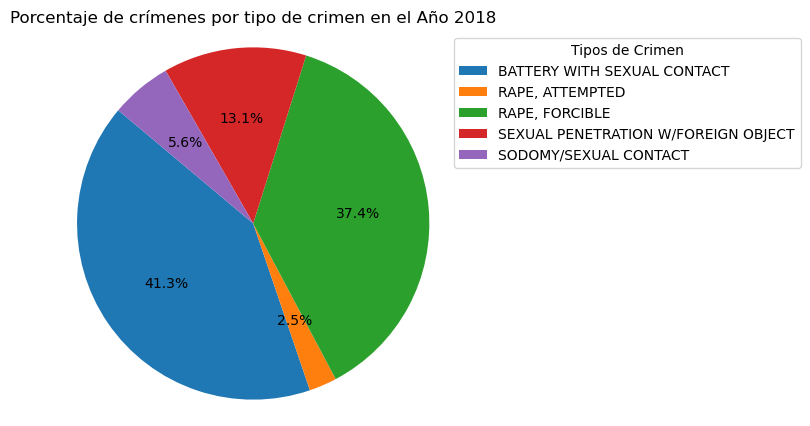

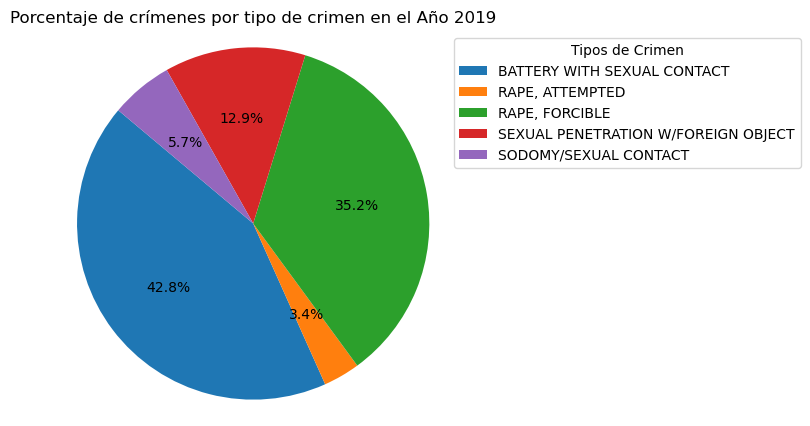

In [14]:
df_filtered['DATE OCC'] = pd.to_datetime(df_filtered['DATE OCC'], format = "%m/%d/%Y %I:%M:%S %p", utc = True)
df_filtered['Only DATE OCC'] = pd.to_datetime(df_filtered['DATE OCC']).dt.date
df_filtered['Only DATE OCC'] = pd.to_datetime(df_filtered['Only DATE OCC'])
df_filtered['Year'] = df_filtered['Only DATE OCC'].dt.year
df_filtered['DATE OCC D'] = df_filtered['DATE OCC'].dt.date
df_filtered['DATE OCC T'] = df_filtered['DATE OCC'].dt.time

grouped = df_filtered.groupby(['Year', 'Crm Cd Desc']).size().reset_index(name='Count')

for year, data in grouped.groupby('Year'):
    plt.figure(figsize=(5, 5))
    plt.pie(data['Count'], labels=None, autopct='%1.1f%%', startangle=140)
    plt.title(f'Porcentaje de crímenes por tipo de crimen en el Año {year}')
    plt.axis('equal')  
    
    plt.legend(data['Crm Cd Desc'], title='Tipos de Crimen', loc='upper left', bbox_to_anchor=(1, 1))

    plt.show()

### Información sobre las victimas

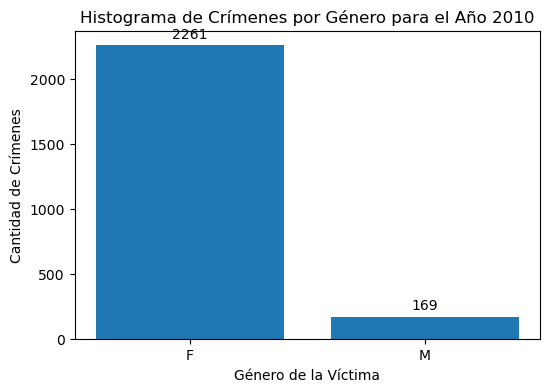

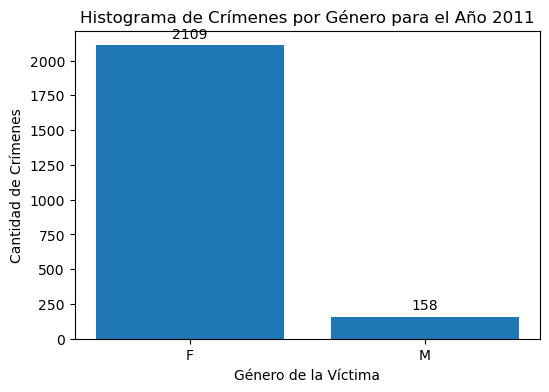

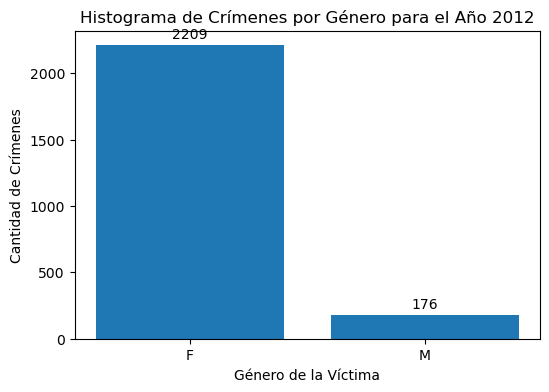

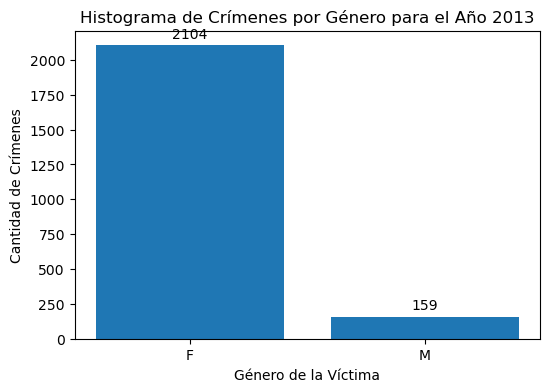

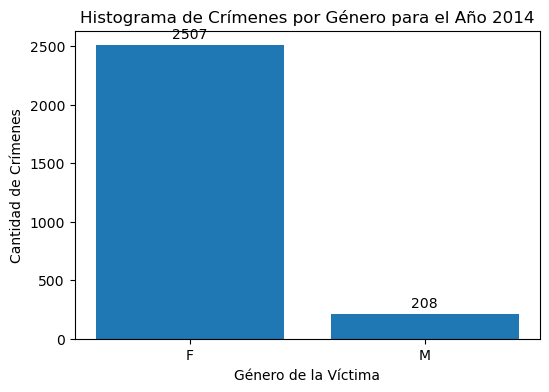

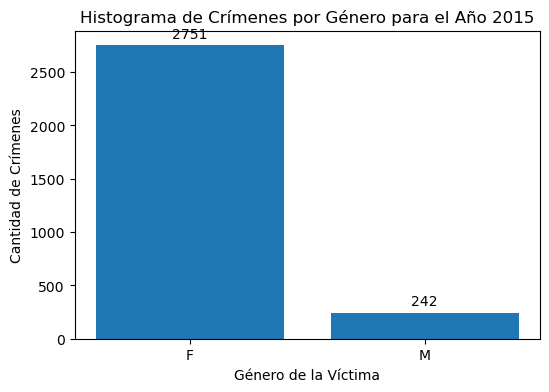

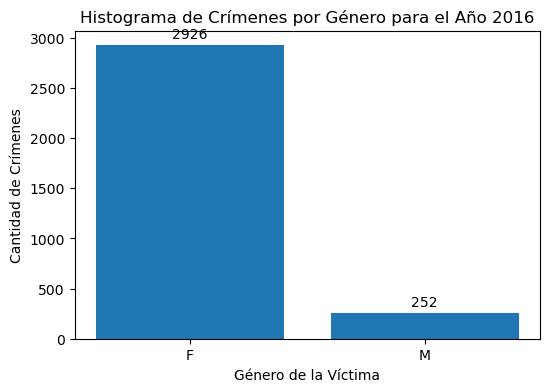

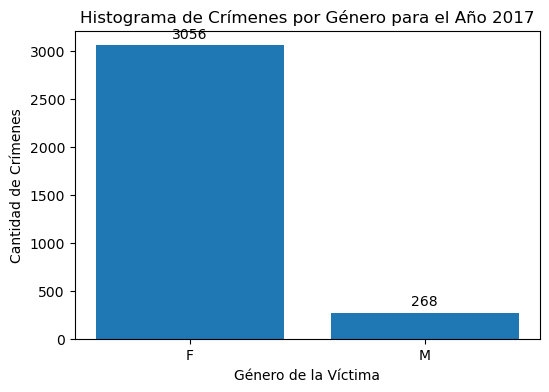

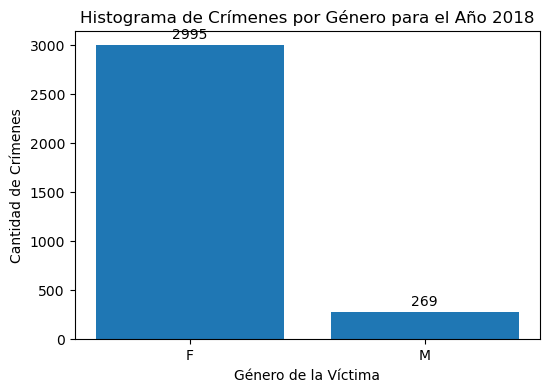

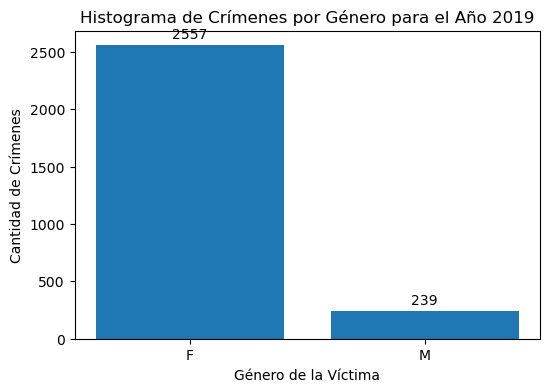

In [15]:
# Agrupamos por año y género de la victima
grouped = df_filtered.groupby(['Year', 'Vict Sex']).size().reset_index(name='Count')

# Obtengo la lista de años únicos
years = grouped['Year'].unique()

# Creo un histograma por cada año
for year in years:
    data_year = grouped[grouped['Year'] == year]
    
    plt.figure(figsize=(6, 4))
    bars = plt.bar(data_year['Vict Sex'], data_year['Count'])
    
    plt.title(f'Histograma de Crímenes por Género para el Año {year}')
    plt.xlabel('Género de la Víctima')
    plt.ylabel('Cantidad de Crímenes')
    
    # Agregar etiquetas
    for bar in bars:
        height = bar.get_height()
        plt.annotate(f'{height}',
                     xy=(bar.get_x() + bar.get_width() / 2, height),
                     xytext=(0, 3),  # Desplazamiento vertical de la etiqueta
                     textcoords="offset points",
                     ha='center', va='bottom')
    
    plt.show()



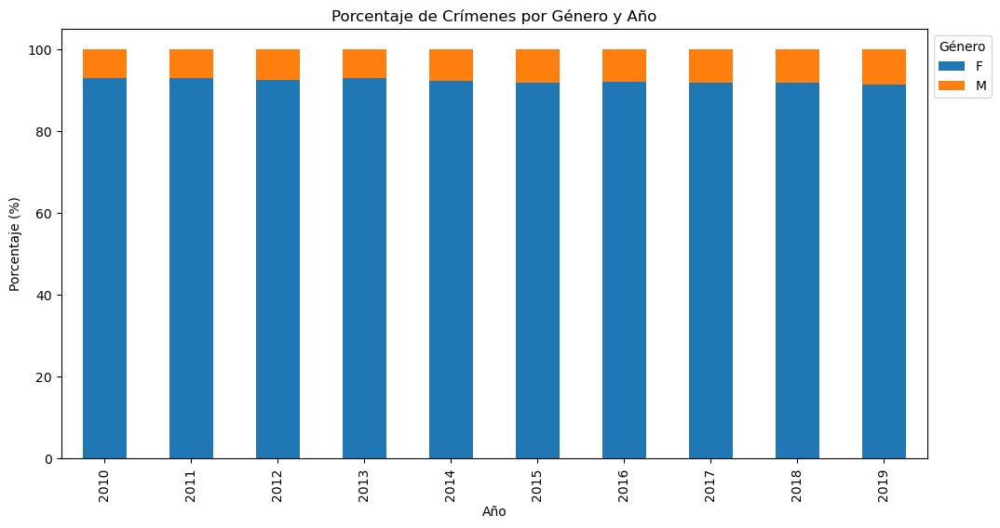

In [16]:
pivot_table = pd.pivot_table(grouped, values='Count', index='Year', columns='Vict Sex', aggfunc='sum', fill_value=0)

pivot_table_percent = pivot_table.div(pivot_table.sum(axis=1), axis=0) * 100

pivot_table_percent.plot(kind='bar', stacked=True, figsize=(12, 6))

plt.title('Porcentaje de Crímenes por Género y Año')
plt.xlabel('Año')
plt.ylabel('Porcentaje (%)')

plt.legend(title='Género', loc='upper left', bbox_to_anchor=(1, 1))
plt.show()

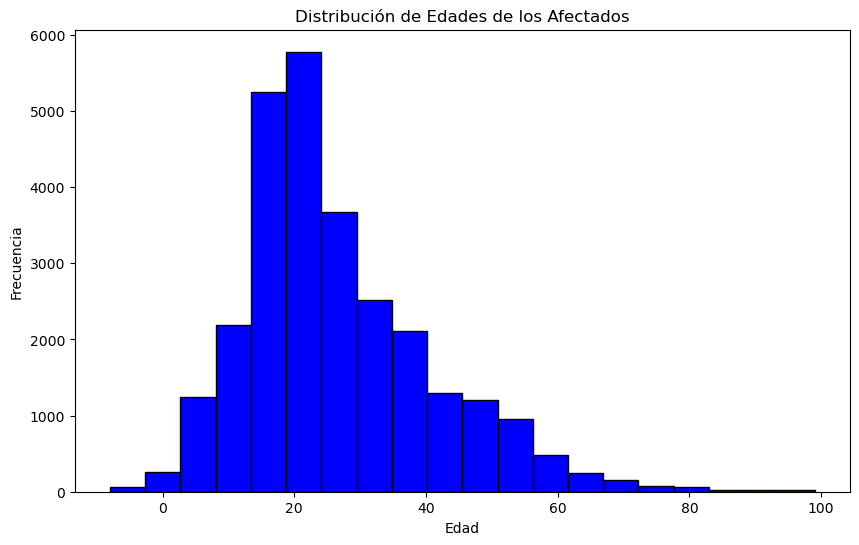

In [17]:
# Crear un histograma de las edades
plt.figure(figsize=(10, 6))
plt.hist(df_filtered['Vict Age'], bins=20, color='blue', edgecolor='black')

# Agregar etiquetas y título
plt.title('Distribución de Edades de los Afectados')
plt.xlabel('Edad')
plt.ylabel('Frecuencia')

# Mostrar el gráfico
plt.show()


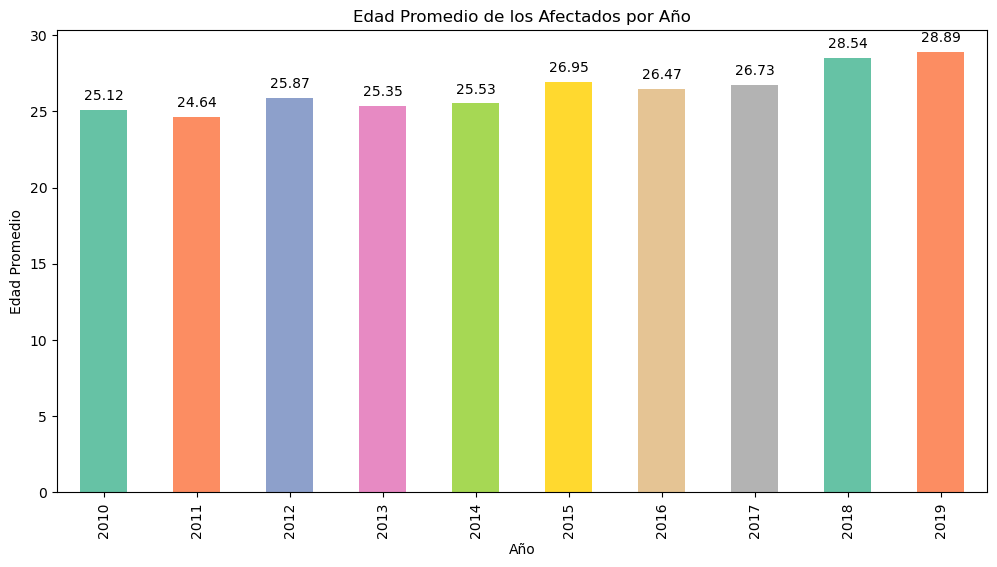

In [18]:

palette = sns.color_palette("Set2", n_colors=len(df_filtered['Year'].unique()))

plt.figure(figsize=(12, 6))
ax = df_filtered.groupby('Year')['Vict Age'].mean().plot(kind='bar', color=palette)

# Agregar etiquetas y título
plt.title('Edad Promedio de los Afectados por Año')
plt.xlabel('Año')
plt.ylabel('Edad Promedio')

# Agregar etiquetas con el número promedio encima de las barras
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points')

# Mostrar el gráfico
plt.show()

# ANÁLISIS AGRESIONES

In [19]:
df_filtered

,DATE OCC,TIME OCC,AREA,AREA NAME,Crm Cd,Crm Cd Desc,Vict Age,Vict Sex,LOCATION,LAT,LON,Only DATE OCC,Year,DATE OCC D,DATE OCC T
4,2010-01-02 00:00:00+00:00,2100,1,Central,122,"RAPE, ATTEMPTED",47,F,8TH ST,34.0387,-118.2488,2010-01-02,2010,2010-01-02,00:00:00
59,2010-03-06 00:00:00+00:00,420,1,Central,121,"RAPE, FORCIBLE",28,F,400 S FIGUEROA ST,34.0535,-118.2560,2010-03-06,2010,2010-03-06,00:00:00
171,2010-05-16 00:00:00+00:00,300,1,Central,860,BATTERY WITH SEXUAL CONTACT,59,F,600 S SAN PEDRO,34.0423,-118.2452,2010-05-16,2010,2010-05-16,00:00:00
244,2010-06-25 00:00:00+00:00,2345,1,Central,121,"RAPE, FORCIBLE",13,F,500 S SPRING ST,34.0474,-118.2496,2010-06-25,2010,2010-06-25,00:00:00
299,2010-07-24 00:00:00+00:00,100,1,Central,121,"RAPE, FORCIBLE",28,F,500 N HILL ST,34.0589,-118.2412,2010-07-24,2010,2010-07-24,00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1866649,2019-06-30 00:00:00+00:00,200,6,Hollywood,860,BATTERY WITH SEXUAL CONTACT,25,F,SELMA,34.0997,-118.3361,2019-06-30,2019,2019-06-30,00:00:00
1866667,2019-06-04 00:00:00+00:00,200,8,West LA,860,BATTERY WITH SEXUAL CONTACT,40,M,11700 SAN VICENTE BL,34.0536,-118.4655,2019-06-04,2019,2019-06-04,00:00:00
1866684,2019-04-14 00:00:00+00:00,200,16,Foothill,860,BATTERY WITH SEXUAL CONTACT,17,F,13000 CARL ST,34.2688,-118.4158,2019-04-14,2019,2019-04-14,00:00:00
1866779,2019-06-30 00:00:00+00:00,730,11,Northeast,121,"RAPE, FORCIBLE",23,F,800 N AVENUE 64,34.1208,-118.1778,2019-06-30,2019,2019-06-30,00:00:00


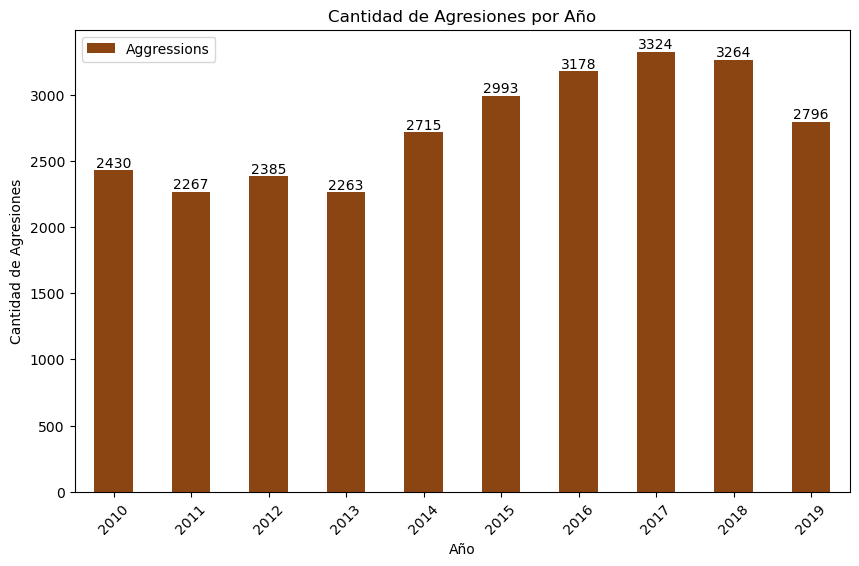

In [20]:
df_years = df_filtered.groupby(df_filtered.Year).size().to_frame().rename(columns={0: 'Aggressions'})

bar_color = '#8B4513' 

ax = df_years.plot(kind='bar', figsize=(10, 6), color=bar_color)
plt.title('Cantidad de Agresiones por Año')
plt.xlabel('Año')
plt.ylabel('Cantidad de Agresiones')
plt.xticks(rotation=45)

for i, v in enumerate(df_years['Aggressions']):
    ax.text(i, v, str(v), ha='center', va='bottom')

plt.show()

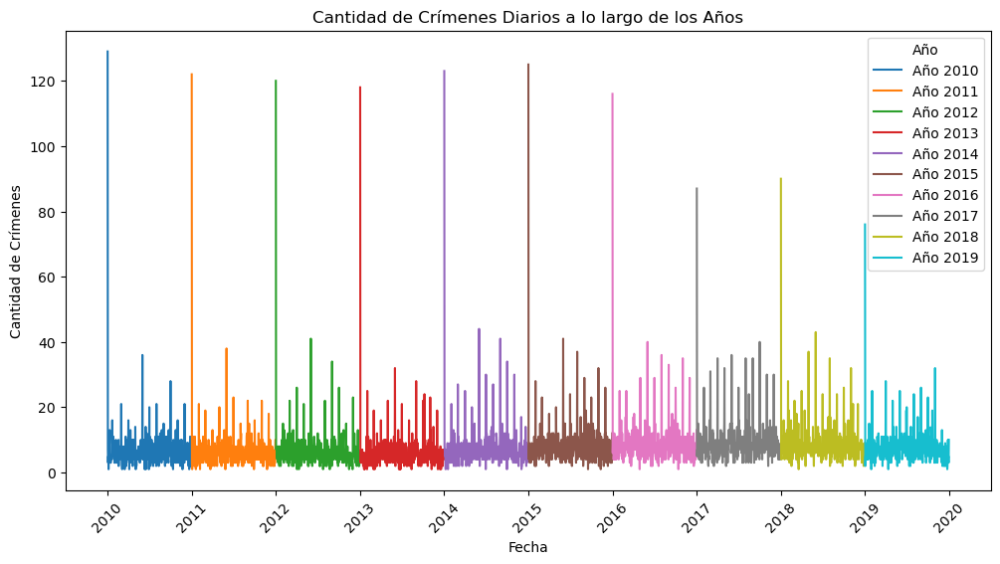

In [21]:
crime_counts = df_filtered.groupby(['Year', df_filtered['DATE OCC'].dt.date]).size()

plt.figure(figsize=(12, 6))

# Iterar a través de los años y trazar una línea para cada año
for year, data in crime_counts.groupby(level=0):
    plt.plot(data.index.get_level_values(1), data.values, label=f'Año {year}')

# Configurar la apariencia de la gráfica
plt.title('Cantidad de Crímenes Diarios a lo largo de los Años')
plt.xlabel('Fecha')
plt.ylabel('Cantidad de Crímenes')
plt.xticks(rotation=45)
plt.legend(title='Año')

# Mostrar la gráfica
plt.show()




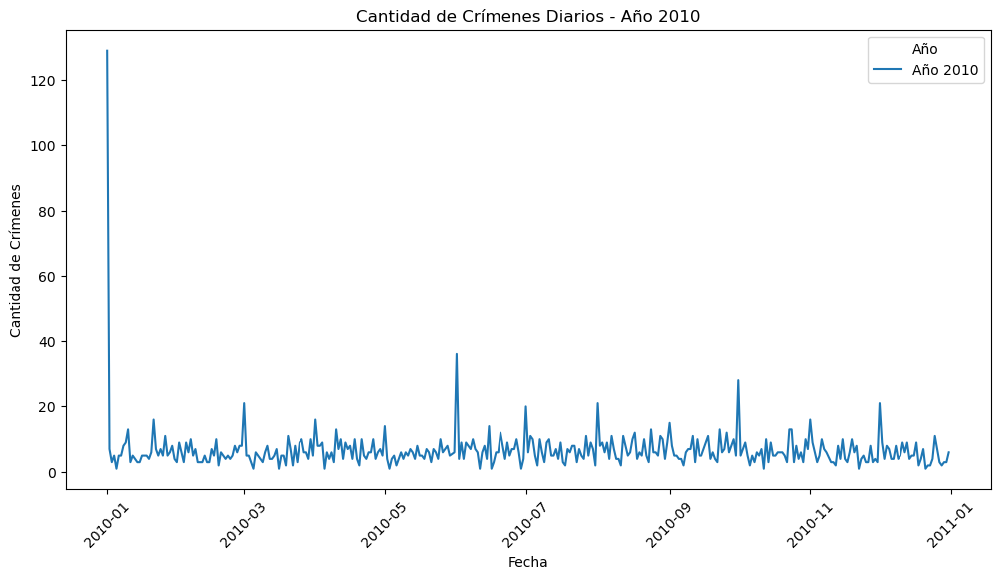

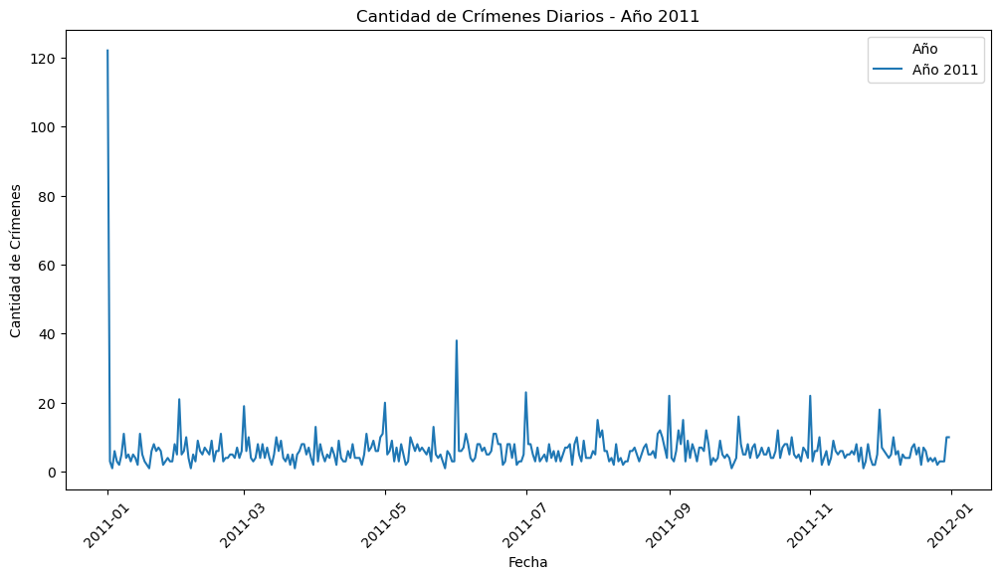

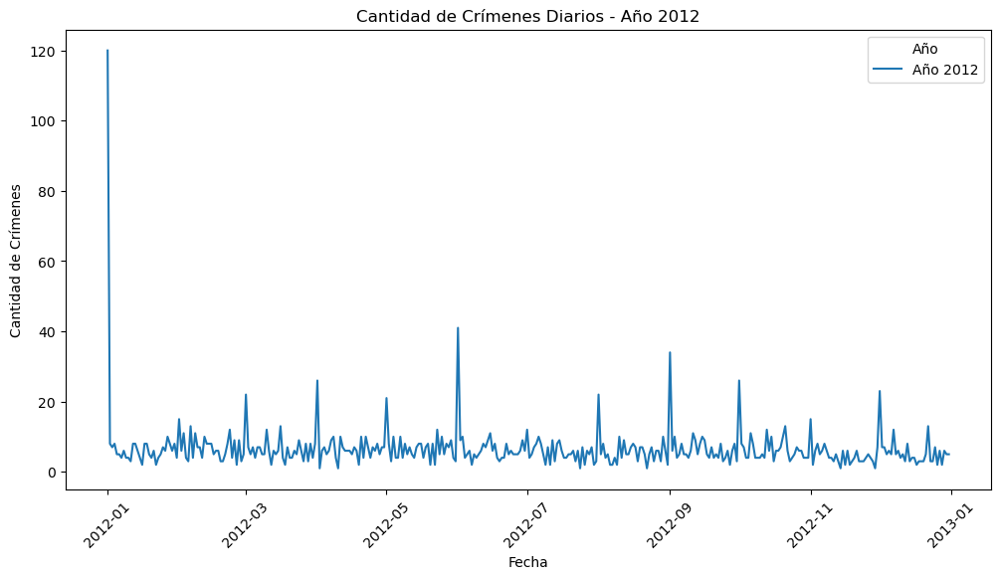

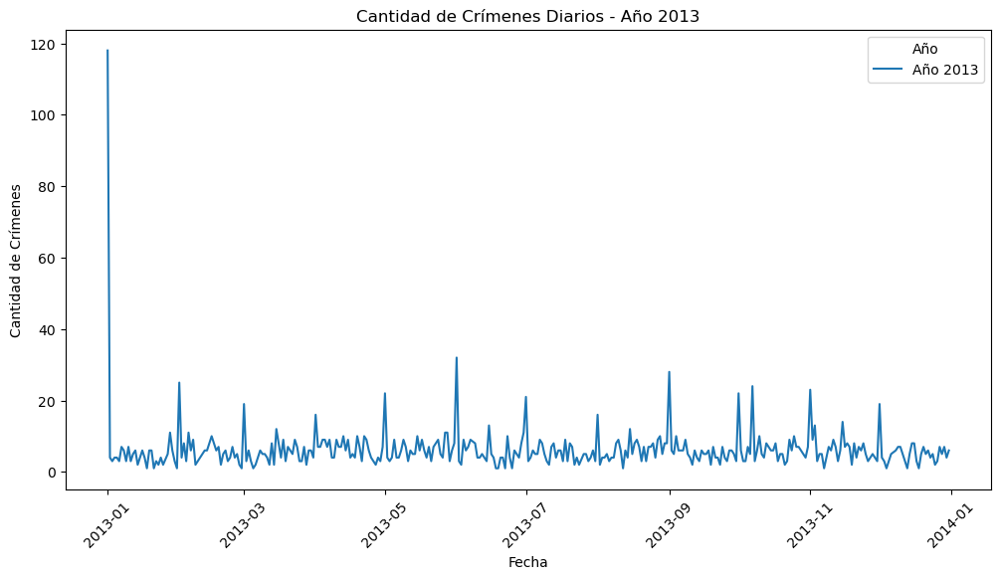

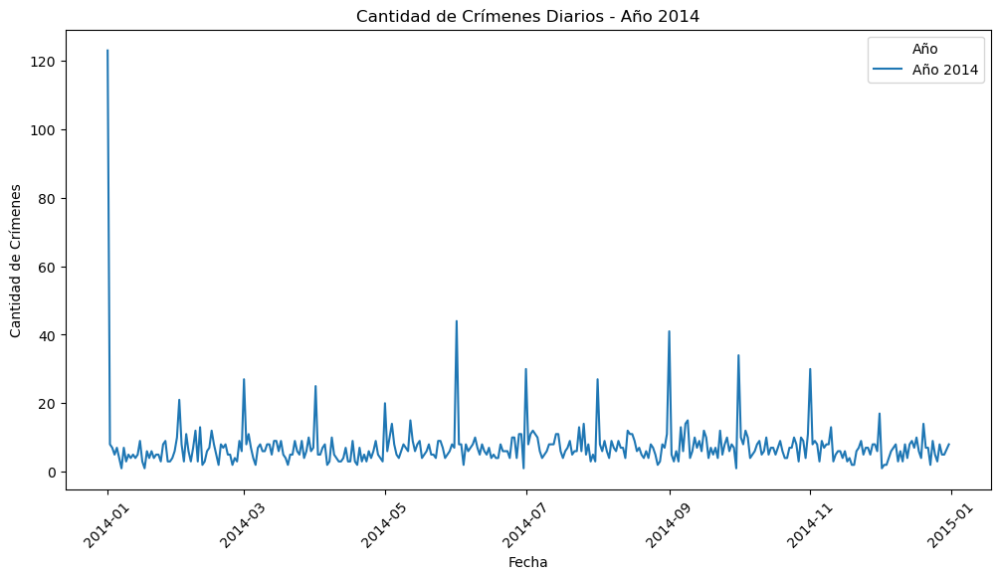

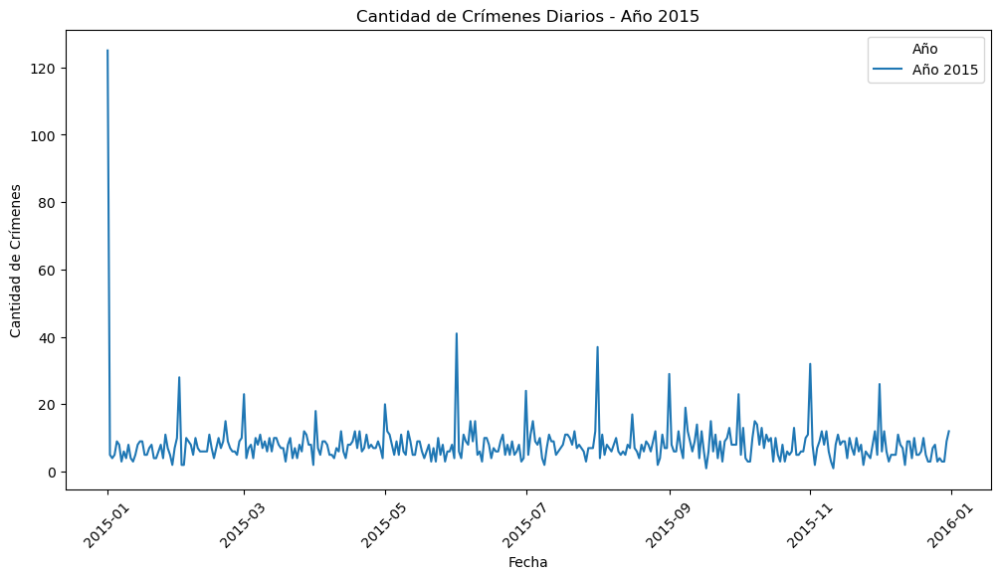

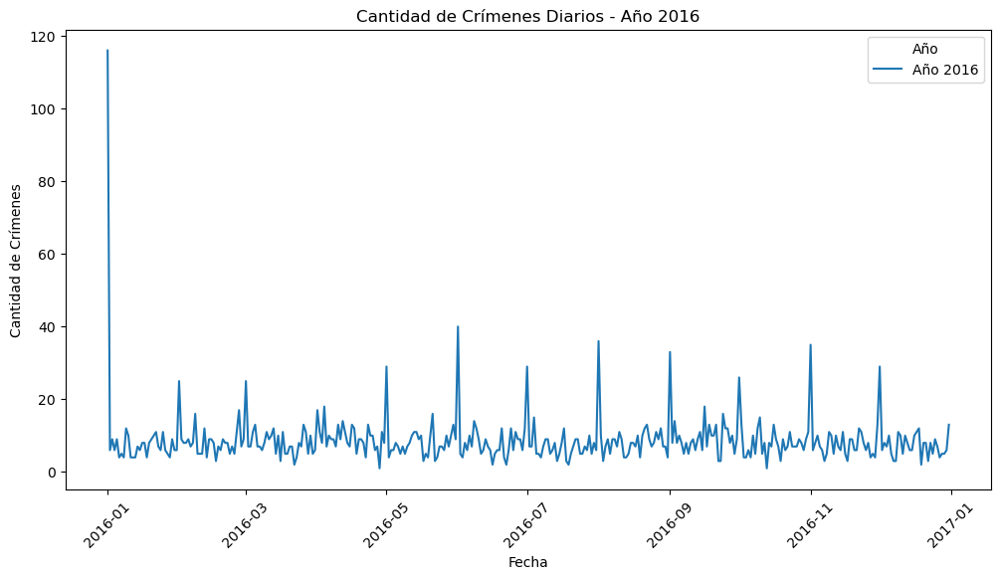

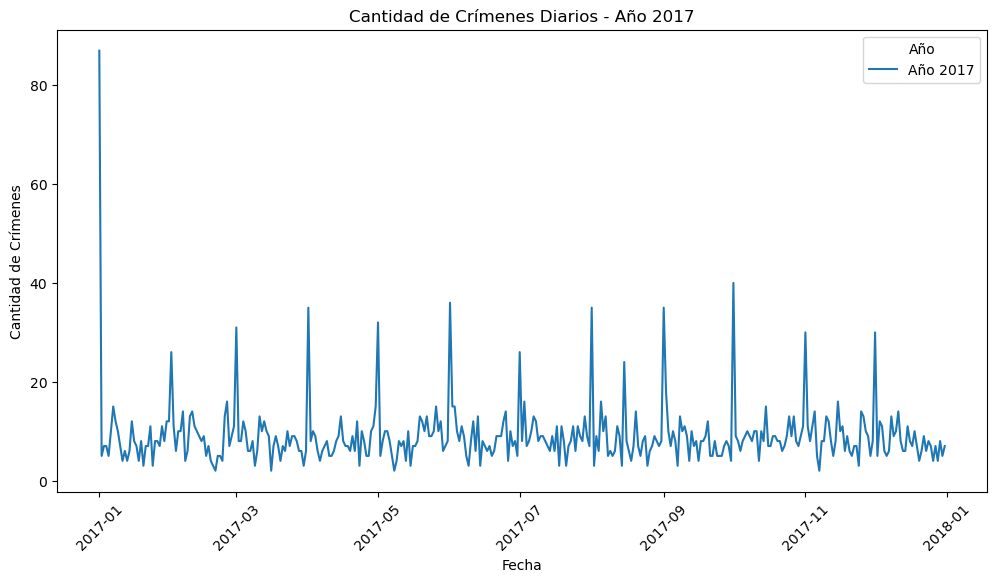

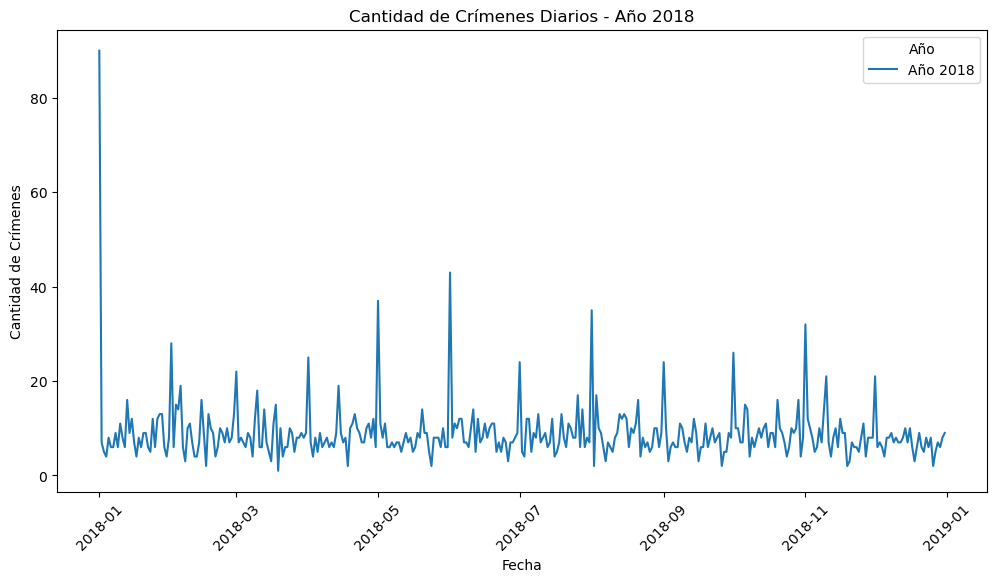

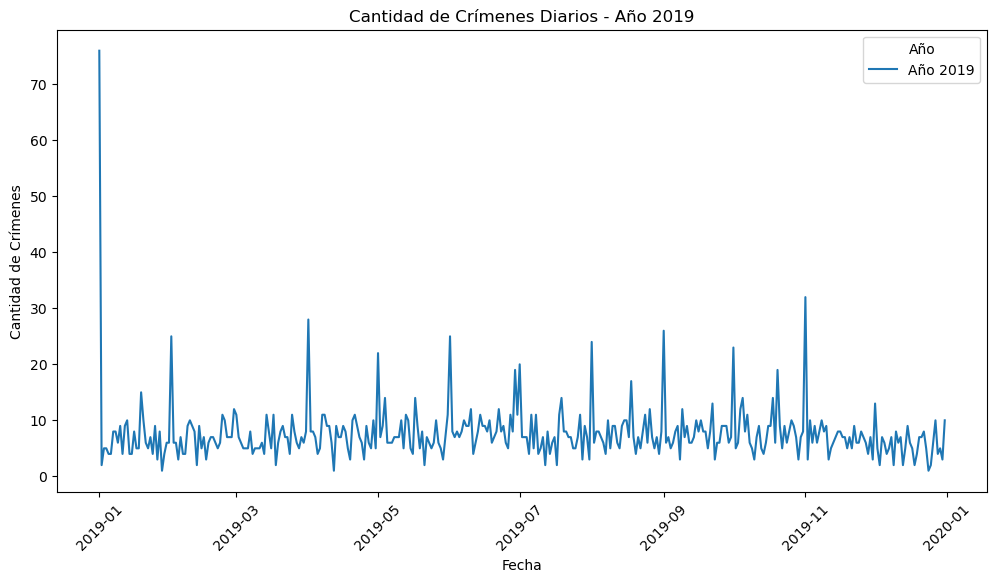

In [22]:
for year, data in crime_counts.groupby(level=0):
    plt.figure(figsize=(12, 6))
    plt.plot(data.index.get_level_values(1), data.values, label=f'Año {year}')

    plt.title(f'Cantidad de Crímenes Diarios - Año {year}')
    plt.xlabel('Fecha')
    plt.ylabel('Cantidad de Crímenes')
    plt.xticks(rotation=45)
    plt.legend(title='Año')

    plt.show()


In [23]:
# Numero de agresiones por año
df_agresiones = df_filtered.groupby(df_filtered['DATE OCC D']).size().to_frame().rename(columns = {0:'Agressions'})
df_agresiones

,Agressions
DATE OCC D,
2010-01-01,129
2010-01-02,7
2010-01-03,3
2010-01-04,5
2010-01-05,1
...,...
2019-12-27,10
2019-12-28,4
2019-12-29,5


## MAP

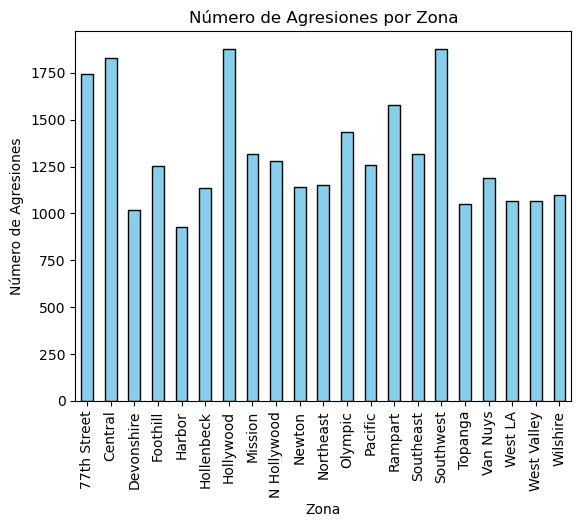

In [24]:
# Agrupa por 'zone' y cuenta el número de agresiones en cada zona
agresiones_por_zona = df_filtered.groupby('AREA NAME').size()

# Crea un gráfico de barras
agresiones_por_zona.plot(kind='bar', color='skyblue', edgecolor='black')

# Agrega etiquetas y título al gráfico
plt.xlabel('Zona')
plt.ylabel('Número de Agresiones')
plt.title('Número de Agresiones por Zona')

# Muestra el gráfico
plt.show()

In [25]:
df_filtered = df_filtered.dropna(subset=['LAT', 'LON'])

mapa = folium.Map(location=[df_filtered['LAT'].iloc[0], df_filtered['LON'].iloc[0]], zoom_start=12)

marker_cluster = MarkerCluster().add_to(mapa)

for index, fila in df_filtered.iterrows():
    if fila['Crm Cd Desc'] == 'RAPE, ATTEMPTED':
        color = 'red'
    elif fila['Crm Cd Desc'] == 'RAPE, FORCIBLE':
        color = 'blue'
    elif fila['Crm Cd Desc'] == 'BATTERY WITH SEXUAL CONTACT':
        color = 'orange'
    elif fila['Crm Cd Desc'] == 'SODOMY/SEXUAL CONTACT':
        color = 'green'
    elif fila['Crm Cd Desc'] == 'SEXUAL PENETRATION W/FOREIGN OBJECT':
        color = 'black'
    else:
        color = 'gray' 
    
    folium.CircleMarker(location=[fila['LAT'], fila['LON']],
                        radius=5,
                        color=color,
                        fill=True,
                        fill_color=color,
                        fill_opacity=0.7,
                        tooltip=fila['Crm Cd Desc']
    ).add_to(marker_cluster)

display(mapa)


# DATASETS PARA MODELOS

In [26]:
def features (data):
    
    df = data.copy()
        
    # Time features
    df['year'] = df.index.year.astype('int')
    df['quarter'] = df.index.quarter.astype('int')
    df['month'] = df.index.month.astype('int')
    df['primavera'] = df.month.apply(lambda x: 1 if x in (3,4,5) else 0)
    df['estiu'] = df.month.apply(lambda x: 1 if x in (6,7,8) else 0)
    df['tardor'] = df.month.apply(lambda x: 1 if x in (9,10,11) else 0)
    df['hivern'] = df.month.apply(lambda x: 1 if x in (12,1,2) else 0)

        
    # Dummy features
    df = pd.get_dummies(df, columns=['year'], drop_first=True)
    df = pd.get_dummies(df, columns=['quarter'], drop_first=True)
    

    # DeterministicProcess
    fourierA = CalendarFourier(freq='A', order=5)
    fourierM = CalendarFourier(freq='M', order=2)
    fourierW = CalendarFourier(freq='W', order=4)
    dp = DeterministicProcess(index=df.index,
                          order=1,
                          seasonal=False,
                          constant=False,
                          additional_terms=[fourierA, fourierM, fourierW],
                          drop=True)
    dp_df = dp.in_sample()
    df = pd.concat([df, dp_df], axis=1)
    
        
    return df

### DATASET DE TODOS LOS DIAS DE LA BASE DE DATOS

In [27]:
#new_df total dies

x = pd.DataFrame()
x = df_crimes.groupby(df_crimes['DATE OCC']).first().reset_index()
x = x['DATE OCC']

df_all_days = df_filtered.groupby(df_crimes['DATE OCC']).size().reset_index()
df_all_days = pd.merge(x.to_frame(), df_all_days, how='left')

df_all_days = df_all_days.fillna(0)
df_all_days = df_all_days.rename(columns = {0:'Agressions'}).set_index('DATE OCC')
df_all_days.index = pd.to_datetime(df_all_days.index)
df_all_days['New Years'] = 0
df_all_days.loc[(df_all_days.index.day == 1) & (df_all_days.index.month == 1), 'New Years'] = 1

#new_df total dies pred
df_all_days.iloc[-14:].Agressions = np.nan

# Adding lags
for l in range(1,5):
    df_all_days[f'agressions_lag_{l}'] = df_all_days['Agressions'].shift(l)
    df_all_days[f'agressions_lag_{l}'] = df_all_days[f'agressions_lag_{l}'].fillna(0)

#mitjanes
df_all_days['agressions_week_avg'] = df_all_days['Agressions'].rolling(7).mean()
df_all_days['agressions_biweek_avg'] = df_all_days['Agressions'].rolling(14).mean()
df_all_days['agressions_1_month_avg'] = df_all_days['Agressions'].rolling(30).mean()
df_all_days['agressions_2_month_avg'] = df_all_days['Agressions'].rolling(60).mean()

df_all_days['agressions_week_avg'] = df_all_days['agressions_week_avg'].fillna(0)
df_all_days['agressions_biweek_avg'] = df_all_days['agressions_biweek_avg'].fillna(0)
df_all_days['agressions_1_month_avg'] = df_all_days['agressions_1_month_avg'].fillna(0)
df_all_days['agressions_2_month_avg'] = df_all_days['agressions_2_month_avg'].fillna(0)

df_all_days = features(df_all_days)

df_all_days.sort_values(by='DATE OCC', inplace=True)
df_all_days

/var/folders/1d/_xylp1812vd2jg38vsf_30w00000gn/T/ipykernel_3184/1501653931.py:12: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_all_days.index = pd.to_datetime(df_all_days.index)
/var/folders/1d/_xylp1812vd2jg38vsf_30w00000gn/T/ipykernel_3184/1501653931.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_all_days.iloc[-14:].Agressions = np.nan


,Agressions,New Years,agressions_lag_1,agressions_lag_2,agressions_lag_3,agressions_lag_4,agressions_week_avg,agressions_biweek_avg,agressions_1_month_avg,agressions_2_month_avg,...,"sin(1,freq=M)","cos(1,freq=M)","sin(2,freq=M)","cos(2,freq=M)","sin(1,freq=W-SUN)","cos(1,freq=W-SUN)","sin(2,freq=W-SUN)","cos(2,freq=W-SUN)","sin(3,freq=W-SUN)","cos(3,freq=W-SUN)"
DATE OCC,,,,,,,,,,,,,,,,,,,,,
2010-01-01,129.0,1,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,1.000000,0.000000,1.000000,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2010-01-02,7.0,0,76.0,90.0,87.0,116.0,89.142857,0.000000,0.000000,0.000000,...,0.201299,0.979530,0.394356,0.918958,-0.974928,-0.222521,0.433884,-0.900969,0.781831,0.623490
2010-01-03,3.0,0,2.0,7.0,5.0,6.0,5.142857,22.214286,0.000000,0.000000,...,0.394356,0.918958,0.724793,0.688967,-0.781831,0.623490,-0.974928,-0.222521,-0.433884,-0.900969
2010-01-04,5.0,0,5.0,5.0,7.0,9.0,6.000000,5.000000,36.266667,0.000000,...,0.571268,0.820763,0.937752,0.347305,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
2010-01-05,1.0,0,5.0,4.0,7.0,6.0,4.714286,5.214286,5.166667,0.000000,...,0.724793,0.688967,0.998717,-0.050649,0.781831,0.623490,0.974928,-0.222521,0.433884,-0.900969
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-27,10.0,0,5.0,7.0,4.0,4.0,6.428571,5.428571,5.300000,5.233333,...,-0.848644,0.528964,-0.897805,-0.440394,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2019-12-28,4.0,0,7.0,4.0,5.0,3.0,4.714286,4.714286,4.533333,4.916667,...,-0.724793,0.688967,-0.998717,-0.050649,-0.974928,-0.222521,0.433884,-0.900969,0.781831,0.623490
2019-12-29,5.0,0,6.0,8.0,5.0,3.0,5.571429,5.071429,4.933333,5.016667,...,-0.571268,0.820763,-0.937752,0.347305,-0.781831,0.623490,-0.974928,-0.222521,-0.433884,-0.900969


In [28]:
df_all_days = df_all_days.to_csv('df_all_days.csv')

### DATASET DE TODOS LOS MESES DE LA BASE DE DATOS

In [29]:
df_crimes['month_year'] = pd.to_datetime(df_crimes['DATE OCC']).dt.to_period('M')

df_all_mesos = df_filtered.groupby([df_crimes['month_year']]).size().to_frame()
df_all_mesos = df_all_mesos.rename(columns = {0:'Agressions'})

df_all_mesos = df_all_mesos.iloc[:-2]
df_all_mesos.iloc[-6:] = np.nan

#Cap d'any
df_all_mesos['New Years'] = 0
df_all_mesos.loc[(df_all_mesos.index.month == 1), 'New Years'] = 1

#mitjanes
df_all_mesos['agressions_2_month_avg'] = df_all_mesos['Agressions'].rolling(2).mean()
df_all_mesos['agressions_6_month_avg'] = df_all_mesos['Agressions'].rolling(6).mean()

df_all_mesos['agressions_2_month_avg'] = df_all_mesos['agressions_2_month_avg'].fillna(0)
df_all_mesos['agressions_6_month_avg'] = df_all_mesos['agressions_6_month_avg'].fillna(0)

#lags
for l in range(1,5):
    df_all_mesos[f'agressions_lag_{l}'] = df_all_mesos['Agressions'].shift(l)
    df_all_mesos[f'agressions_lag_{l}'] = df_all_mesos[f'agressions_lag_{l}'].fillna(0)

df_all_mesos = features(df_all_mesos)

df_all_mesos

/var/folders/1d/_xylp1812vd2jg38vsf_30w00000gn/T/ipykernel_3184/4066537813.py:1: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_crimes['month_year'] = pd.to_datetime(df_crimes['DATE OCC']).dt.to_period('M')
/Users/oscar_sanchez/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/deterministic.py:1246: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  is_constant[const_locs[:1]] = False


,Agressions,New Years,agressions_2_month_avg,agressions_6_month_avg,agressions_lag_1,agressions_lag_2,agressions_lag_3,agressions_lag_4,month,primavera,...,"cos(4,freq=A-DEC)","sin(5,freq=A-DEC)","cos(5,freq=A-DEC)","cos(1,freq=M)","sin(1,freq=W-SUN)","cos(1,freq=W-SUN)","sin(2,freq=W-SUN)","cos(2,freq=W-SUN)","cos(3,freq=W-SUN)","sin(4,freq=W-SUN)"
month_year,,,,,,,,,,,,,,,,,,,,,
2010-01,305.0,1,0.0,0.0,0.0,0.0,0.0,0.0,1,0,...,1.000000,0.000000,1.000000,1.0,-0.433884,-0.900969,0.781831,0.623490,-0.222521,0.974928
2010-02,158.0,0,231.5,0.0,305.0,0.0,0.0,0.0,2,0,...,-0.534373,0.455907,-0.890028,1.0,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000
2010-03,181.0,0,169.5,0.0,158.0,305.0,0.0,0.0,3,1,...,-0.605056,-0.933837,0.357698,1.0,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000
2010-04,202.0,0,191.5,0.0,181.0,158.0,305.0,0.0,4,1,...,0.996298,0.994218,0.107381,1.0,0.433884,-0.900969,-0.781831,0.623490,-0.222521,-0.974928
2010-05,169.0,0,185.5,0.0,202.0,181.0,158.0,305.0,5,1,...,-0.397543,-0.785650,-0.618671,1.0,-0.974928,-0.222521,0.433884,-0.900969,0.623490,-0.781831
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-06,NaN,0,0.0,0.0,0.0,236.0,205.0,208.0,6,0,...,-0.563151,0.417194,0.908818,1.0,-0.974928,-0.222521,0.433884,-0.900969,0.623490,-0.781831
2019-07,NaN,0,0.0,0.0,0.0,0.0,236.0,205.0,7,0,...,0.994671,0.128748,-0.991677,1.0,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000
2019-08,NaN,0,0.0,0.0,0.0,0.0,0.0,236.0,8,0,...,-0.444378,-0.566702,0.823923,1.0,0.433884,-0.900969,-0.781831,0.623490,-0.222521,-0.974928


In [30]:
df_all_mesos = df_all_mesos.to_csv('df_all_mesos.csv')

### DATASET DE TODOS LOS DIAS AGRUPADO POR AREAS DE LA BASE DE DATOS

In [31]:

df_all_days_by_area = df_filtered.groupby([df_crimes['DATE OCC'], df_crimes['AREA ']]).count().unstack(fill_value=0).stack()

df_all_days_by_area = df_all_days_by_area.iloc[:, :-14]

df_all_days_by_area = df_all_days_by_area.rename(columns = {'DATE OCC':'Agressions'})

#exemple de dataset fet per data i war
df_all_days_by_area= df_all_days_by_area.reset_index().set_index('DATE OCC')
df_all_days_by_area.index = pd.to_datetime(df_all_days_by_area.index)

#Cap d'Any
df_all_days_by_area = df_all_days_by_area[df_all_days_by_area['AREA '] != 0]
df_all_days_by_area.loc[(df_all_days_by_area.index.day == 1) & (df_all_days_by_area.index.month == 1), 'New Years'] = 1

#Pred
df_all_days_by_area.iloc[-1078:].Agressions = np.nan

#lags
for l in range(1,5):
    for i in df_all_days_by_area['AREA '].unique():
        df_all_days_by_area.loc[df_all_days_by_area['AREA '] == i, f'agressions_lag_{l}'] = df_all_days_by_area.loc[df_all_days_by_area['AREA '] == i].Agressions.shift(l)
    df_all_days_by_area[f'agressions_lag_{l}'] = df_all_days_by_area[f'agressions_lag_{l}'].fillna(0)


#mitjanes
for i in df_all_days_by_area['AREA '].unique():
    df_all_days_by_area.loc[df_all_days_by_area['AREA '] == i, 'agressions_community_1_month_avg'] = df_all_days_by_area[df_all_days_by_area['AREA '] == i].Agressions.rolling(30).mean().fillna(0)
    df_all_days_by_area.loc[df_all_days_by_area['AREA '] == i, 'agressions_community_2_month_avg'] = df_all_days_by_area[df_all_days_by_area['AREA '] == i].Agressions.rolling(60).mean().fillna(0)

df_all_days_by_area = features(df_all_days_by_area)

df_all_days_by_area

/var/folders/1d/_xylp1812vd2jg38vsf_30w00000gn/T/ipykernel_3184/1855916892.py:9: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_all_days_by_area.index = pd.to_datetime(df_all_days_by_area.index)
/var/folders/1d/_xylp1812vd2jg38vsf_30w00000gn/T/ipykernel_3184/1855916892.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_all_days_by_area.iloc[-1078:].Agressions = np.nan


,AREA,Agressions,New Years,agressions_lag_1,agressions_lag_2,agressions_lag_3,agressions_lag_4,agressions_community_1_month_avg,agressions_community_2_month_avg,month,...,"sin(1,freq=M)","cos(1,freq=M)","sin(2,freq=M)","cos(2,freq=M)","sin(1,freq=W-SUN)","cos(1,freq=W-SUN)","sin(2,freq=W-SUN)","cos(2,freq=W-SUN)","sin(3,freq=W-SUN)","cos(3,freq=W-SUN)"
DATE OCC,,,,,,,,,,,,,,,,,,,,,
2010-01-01,1,2,1.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1,...,0.000000,1.00000,0.000000,1.000000,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2010-01-01,2,13,1.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1,...,0.000000,1.00000,0.000000,1.000000,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2010-01-01,3,13,1.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1,...,0.000000,1.00000,0.000000,1.000000,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2010-01-01,4,12,1.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1,...,0.000000,1.00000,0.000000,1.000000,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2010-01-01,5,8,1.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1,...,0.000000,1.00000,0.000000,1.000000,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-31,17,0,NaN,0.0,1.0,0.0,0.0,0.233333,0.183333,12,...,-0.201299,0.97953,-0.394356,0.918958,0.781831,0.623490,0.974928,-0.222521,0.433884,-0.900969
2019-12-31,18,0,NaN,1.0,1.0,0.0,0.0,0.400000,0.350000,12,...,-0.201299,0.97953,-0.394356,0.918958,0.781831,0.623490,0.974928,-0.222521,0.433884,-0.900969
2019-12-31,19,0,NaN,1.0,0.0,0.0,2.0,0.300000,0.216667,12,...,-0.201299,0.97953,-0.394356,0.918958,0.781831,0.623490,0.974928,-0.222521,0.433884,-0.900969


In [32]:
df_all_days_by_area = df_all_days_by_area.to_csv('df_all_days_by_area.csv')

### DATASET DE TODOS LOS MESES AGRUPADO POR AREAS DE LA BASE DE DATOS

In [33]:
#community mesos
df_crimes['month_year'] = pd.to_datetime(df_crimes['DATE OCC']).dt.to_period('M')

df_all_mesos_by_area = df_filtered.groupby([df_crimes['month_year'], df_crimes['AREA ']]).count().unstack(fill_value=0).stack()
df_all_mesos_by_area = df_all_mesos_by_area.iloc[:, :-14]
df_all_mesos_by_area = df_all_mesos_by_area.rename(columns = {'DATE OCC':'Agressions'})
df_all_mesos_by_area= df_all_mesos_by_area.reset_index().set_index('month_year')
df_all_mesos_by_area = df_all_mesos_by_area[ df_all_mesos_by_area['AREA '] != 0]

df_all_mesos_by_area = df_all_mesos_by_area.loc[df_all_mesos_by_area.index.year != 2023]
df_all_mesos_by_area.loc[(df_all_mesos_by_area.index.year == 2022) & (df_all_mesos_by_area.index.month > 6), 'Agressions'] = np. nan
#Cap d'any
df_all_mesos_by_area['New Years'] = 0
df_all_mesos_by_area.loc[(df_all_mesos_by_area.index.month == 1), 'New Years'] = 1

#mitjanes
for i in df_all_mesos_by_area['AREA '].unique():
    df_all_mesos_by_area.loc[df_all_mesos_by_area['AREA '] == i, 'agressions_community_2_month_avg'] = df_all_mesos_by_area[df_all_mesos_by_area['AREA '] == i].Agressions.rolling(2).mean().fillna(0)
    df_all_mesos_by_area.loc[df_all_mesos_by_area['AREA '] == i, 'agressions_community_6_month_avg'] = df_all_mesos_by_area[df_all_mesos_by_area['AREA '] == i].Agressions.rolling(6).mean().fillna(0)

#lags
for l in range(1,5):
    for i in df_all_mesos_by_area['AREA '].unique():
        df_all_mesos_by_area.loc[df_all_mesos_by_area['AREA '] == i, f'agressions_lag_{l}'] = df_all_mesos_by_area.loc[df_all_mesos_by_area['AREA '] == i].Agressions.shift(l)
    df_all_mesos_by_area[f'agressions_lag_{l}'] = df_all_mesos_by_area[f'agressions_lag_{l}'].fillna(0)
    
df_all_mesos_by_area = features(df_all_mesos_by_area)

df_all_mesos_by_area

/var/folders/1d/_xylp1812vd2jg38vsf_30w00000gn/T/ipykernel_3184/3539286872.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_crimes['month_year'] = pd.to_datetime(df_crimes['DATE OCC']).dt.to_period('M')
/Users/oscar_sanchez/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/deterministic.py:1246: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  is_constant[const_locs[:1]] = False


,AREA,Agressions,New Years,agressions_community_2_month_avg,agressions_community_6_month_avg,agressions_lag_1,agressions_lag_2,agressions_lag_3,agressions_lag_4,month,...,"cos(4,freq=A-DEC)","sin(5,freq=A-DEC)","cos(5,freq=A-DEC)","cos(1,freq=M)","sin(1,freq=W-SUN)","cos(1,freq=W-SUN)","sin(2,freq=W-SUN)","cos(2,freq=W-SUN)","sin(3,freq=W-SUN)","cos(3,freq=W-SUN)"
month_year,,,,,,,,,,,,,,,,,,,,,
2010-01,1,11.0,1,0.0,0.000000,0.0,0.0,0.0,0.0,1,...,1.000000,0.000000,1.000000,1.0,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2010-01,2,23.0,1,0.0,0.000000,0.0,0.0,0.0,0.0,1,...,1.000000,0.000000,1.000000,1.0,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2010-01,3,29.0,1,0.0,0.000000,0.0,0.0,0.0,0.0,1,...,1.000000,0.000000,1.000000,1.0,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2010-01,4,19.0,1,0.0,0.000000,0.0,0.0,0.0,0.0,1,...,1.000000,0.000000,1.000000,1.0,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2010-01,5,12.0,1,0.0,0.000000,0.0,0.0,0.0,0.0,1,...,1.000000,0.000000,1.000000,1.0,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12,17,10.0,0,7.5,7.666667,5.0,13.0,4.0,7.0,12,...,-0.534373,-0.455907,-0.890028,1.0,-0.781831,0.623490,-0.974928,-0.222521,-0.433884,-0.900969
2019-12,18,9.0,0,10.0,10.833333,11.0,16.0,8.0,12.0,12,...,-0.534373,-0.455907,-0.890028,1.0,-0.781831,0.623490,-0.974928,-0.222521,-0.433884,-0.900969
2019-12,19,4.0,0,5.0,8.333333,6.0,5.0,13.0,8.0,12,...,-0.534373,-0.455907,-0.890028,1.0,-0.781831,0.623490,-0.974928,-0.222521,-0.433884,-0.900969


In [34]:
df_all_mesos_by_area = df_all_mesos_by_area.to_csv('df_all_mesos_by_area.csv')

# Extraer dataset

In [35]:
df_crimes = df_crimes.to_csv('df_crimes.csv')
df_filtered = df_filtered.to_csv('df_filtered.csv')